In [9]:
import cv2
import os
import numpy as np
from PIL import Image
import random
import matplotlib.pyplot as plt



input_dir = "./Datasets/faces"
output_dir = "./Datasets/faces_preprocessed"

In [2]:
!pip install dlib


/bin/pip:6: DeprecationWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html
  from pkg_resources import load_entry_point
     |████████████████████████████████| 3.4 MB 3.2 MB/s eta 0:00:01
  ERROR: Command errored out with exit status 1:
   command: /usr/bin/python3 -u -c 'import sys, setuptools, tokenize; sys.argv[0] = '"'"'/tmp/pip-install-bh6wqukt/dlib/setup.py'"'"'; __file__='"'"'/tmp/pip-install-bh6wqukt/dlib/setup.py'"'"';f=getattr(tokenize, '"'"'open'"'"', open)(__file__);code=f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' bdist_wheel -d /tmp/pip-wheel-ikvwjs2l
       cwd: /tmp/pip-install-bh6wqukt/dlib/
  Complete output (41 lines):
  running bdist_wheel
  running build
  running build_ext
  
  
                     CMake is not installed on your system!
  
      Or it is possible some broken copy of cmake is installed on your system.
      It is unfortunately very co

In [3]:
import dlib

ModuleNotFoundError: No module named 'dlib'

In [12]:
import os
import cv2
import numpy as np
import random
import matplotlib.pyplot as plt

face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")

def normalize_image(image):
    return image.astype(np.float32) / 255.0

def align_face(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=5, minSize=(30, 30))

    if len(faces) == 0:
        print("No face detected!")
        return image

    x, y, w, h = faces[0]
    aligned_face = image[y:y+h, x:x+w]
    aligned_face_resized = cv2.resize(aligned_face, (224, 224))

    return aligned_face_resized

def resize_image(image, target_size=(224, 224)):
    return cv2.resize(image, target_size)

def augment_image(image):
    if random.random() > 0.5:
        image = cv2.flip(image, 1)

    angle = random.uniform(-30, 30)
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    rot_mat = cv2.getRotationMatrix2D(center, angle, scale=1.0)
    image = cv2.warpAffine(image, rot_mat, (w, h))

    return image

def prepare_face_dataset(input_dir, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    for file in os.listdir(input_dir):
        if file.endswith(".jpg"):
            file_path = os.path.join(input_dir, file)

            image = cv2.imread(file_path)
            if image is None:
                print(f"Failed to load image: {file}")
                continue

            normalized_image = normalize_image(image)
            aligned_image = align_face(image)
            resized_image = resize_image(aligned_image)
            augmented_image = augment_image(resized_image)

            output_file_path = os.path.join(output_dir, file.split('.')[0] + "_augmented.jpg")
            cv2.imwrite(output_file_path, augmented_image)

            # plt.imshow(cv2.cvtColor(augmented_image, cv2.COLOR_BGR2RGB))
            # plt.title(f"Processed Image: {file}")
            # plt.axis("off")
            # plt.show()
 

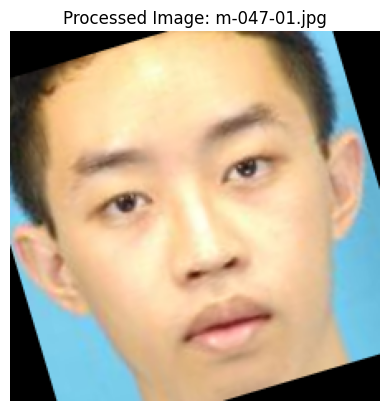

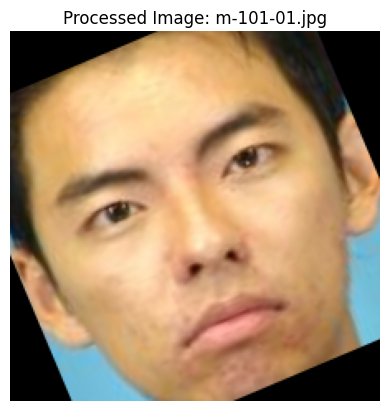

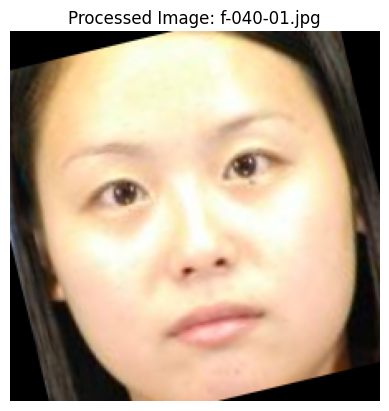

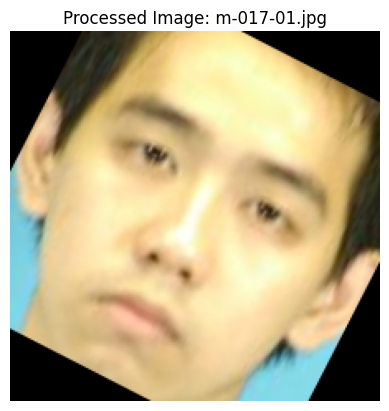

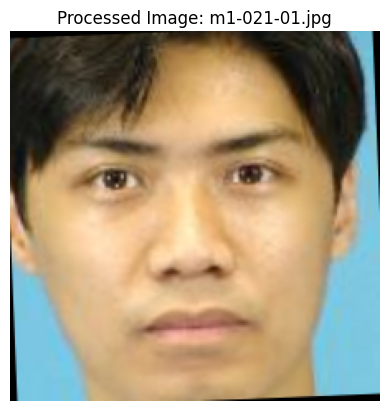

...

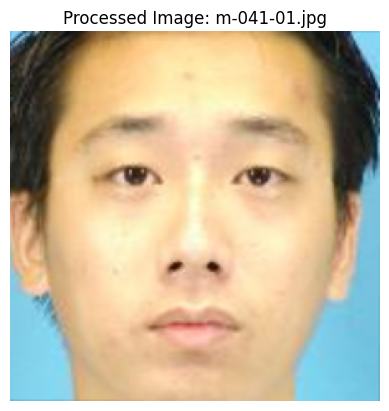

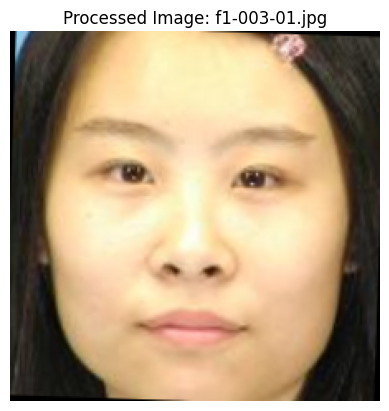

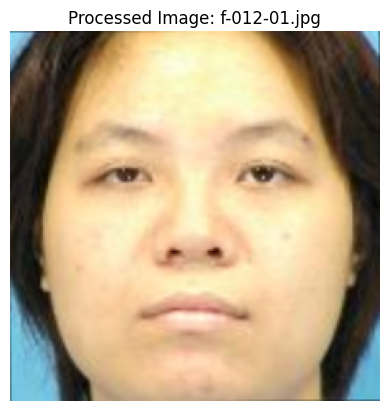

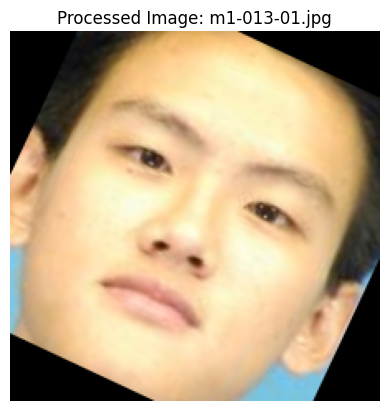

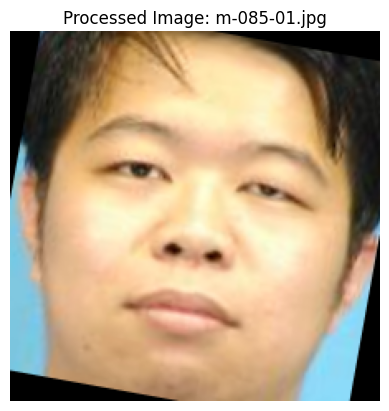

In [17]:
import cv2
import os
import random
import numpy as np
import matplotlib.pyplot as plt

# Face Cascade
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")

def normalize_image(image):
    return image.astype(np.float32) / 255.0

def align_face(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=5, minSize=(30, 30))

    if len(faces) == 0:
        print("No face detected!")
        return image

    x, y, w, h = faces[0]
    aligned_face = image[y:y+h, x:x+w]
    
    aligned_face_resized = cv2.resize(aligned_face, (224, 224))

    return aligned_face_resized

def resize_image(image, target_size=(224, 224)):
    return cv2.resize(image, target_size)

def augment_image(image):
    if random.random() > 0.5:
        image = cv2.flip(image, 1)

    angle = random.uniform(-30, 30)
    h, w = image.shape[:2]
    center = (w // 2, h // 2)
    rot_mat = cv2.getRotationMatrix2D(center, angle, scale=1.0)
    image = cv2.warpAffine(image, rot_mat, (w, h))

    return image

def prepare_face_dataset(input_dir, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    processed_images = []  # To store processed images and filenames

    for file in os.listdir(input_dir):
        if file.endswith(".jpg"):
            file_path = os.path.join(input_dir, file)

            image = cv2.imread(file_path)
            if image is None:
                print(f"Failed to load image: {file}")
                continue

            normalized_image = normalize_image(image)
            aligned_image = align_face(image)
            resized_image = resize_image(aligned_image)
            augmented_image = augment_image(resized_image)

            output_file_path = os.path.join(output_dir, file.split('.')[0] + "_augmented.jpg")
            cv2.imwrite(output_file_path, augmented_image)

            processed_images.append((augmented_image, output_file_path))

            # Optionally show the processed image
            plt.imshow(cv2.cvtColor(augmented_image, cv2.COLOR_BGR2RGB))
            plt.title(f"Processed Image: {file}")
            plt.axis("off")
            plt.show()

    return processed_images  # Return processed images

# Example usage
input_dir = "./Datasets/faces"
output_dir = "./Datasets/faces_preprocessed"
processed_images = prepare_face_dataset(input_dir, output_dir)  # This returns the list of processed images


In [13]:
input_dir = "./Datasets/faces"
output_dir = "./Datasets/faces_preprocessed"
prepare_face_dataset(input_dir, output_dir)

In [14]:
from deepface import DeepFace

def fine_tune_deepface(images):
    embeddings = []

    for img, filename in images:
        # Save images temporarily to extract embeddings
        temp_filename = "./temp.jpg"
        cv2.imwrite(temp_filename, img)

        # Use DeepFace to extract the embedding for each image
        try:
            # Represent the image using the pre-trained model
            representation = DeepFace.represent(img_path=temp_filename, model_name="Facenet")[0]
            embedding = representation["embedding"]
            embeddings.append((filename, embedding))
            print(f"Image: {filename}, Embedding: {embedding}")
        except Exception as e:
            print(f"Error processing {filename}: {e}")

    return embeddings

2025-04-25 01:17:46.733696: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-04-25 01:17:46.735593: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-04-25 01:17:46.778948: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-04-25 01:17:46.779597: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-04-25 01:17:47.586449: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Co

In [19]:
import os
from deepface import DeepFace
import cv2
import numpy as np

def fine_tune_deepface(input_dir):
    embeddings = []

    for file_name in os.listdir(input_dir):
        if file_name.endswith(".jpg") or file_name.endswith(".jpeg"):  # Check if the file is an image
            file_path = os.path.join(input_dir, file_name)
            
            img = cv2.imread(file_path)

            temp_filename = "./temp.jpg"
            cv2.imwrite(temp_filename, img)

            try:
                
                embedding = DeepFace.represent(img_path=temp_filename, model_name="VGG-Face", enforce_detection=False)
                embeddings.append(embedding)
            except ValueError as e:
                print(f"Error processing {file_name}: {e}")

    return embeddings

input_dir = "./Datasets/faces_preprocessed" 
embeddings = fine_tune_deepface(input_dir)
print("Embeddings:", embeddings)


Embeddings: [[{'embedding': [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.07288190971737864, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.009652818557255886, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.057779035609357376, 0.0, 0.0, 0.052015589212096404, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.04215732616346661, 0.008031200224317515, 0.0, 0.0, 0.0, 0.011006417708757323, 0.0, 0.0, 0.06984919120942114, 0.0, 0.0786922847442045, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.02301352898222499, 0.0, 0.0, 0.0, 0.0, 0.0, 0.04208257276330889, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.006306743430550107, 0.0, 0.05780247604431611, 0.0, 0.04036952654530668, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.053556019328379965, 0.004238519858527373, 0.0, 0.1361551642234800

In [27]:
for i, emb in enumerate(embeddings[:10]):
    print(f"Embedding {i+1} shape:", np.array(emb[0]["embedding"]).shape)
    print(emb[0]["embedding"][:200])  
    print()



Embedding 1 shape: (4096,)
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.07288190971737864, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.009652818557255886, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.057779035609357376, 0.0, 0.0, 0.052015589212096404, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.04215732616346661, 0.008031200224317515, 0.0, 0.0, 0.0, 0.011006417708757323, 0.0, 0.0, 0.06984919120942114, 0.0, 0.0786922847442045, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.02301352898222499, 0.0, 0.0, 0.0, 0.0, 0.0, 0.04208257276330889, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.006306743430550107, 0.0, 0.05780247604431611, 0.0, 0.04036952654530668, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.053556019328379965, 0.004238519858527373, 0.0, 0.13615516422348006

In [28]:
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
import numpy as np

# Flatten embeddings (they're currently in nested dicts/lists)
flat_embeddings = [np.array(e[0]["embedding"]) for e in embeddings]

# Standardize features
X = StandardScaler().fit_transform(flat_embeddings)
clustering = DBSCAN(eps=0.6, min_samples=2, metric='cosine').fit(X)

# Print cluster labels (same cluster = same person, ideally)
print(clustering.labels_)


[-1 -1 -1 -1 -1 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  0 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  0 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  0]


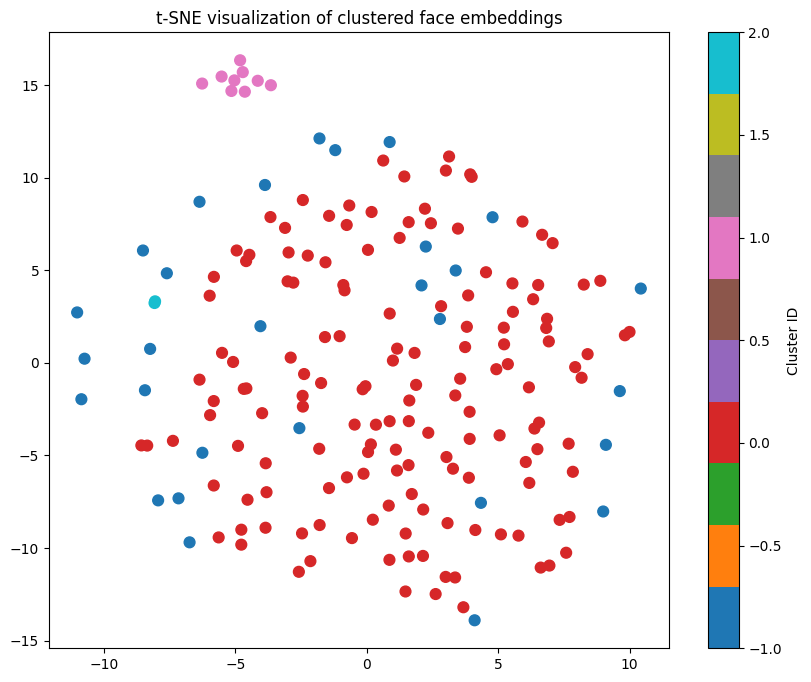

In [29]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.cluster import DBSCAN

# Assuming `embeddings` is a list of dicts like [{'embedding': [...]}, ...]
X = np.array([e[0]["embedding"] for e in embeddings])  # Shape: (n_samples, 2622)

# Clustering (if you haven't already)
clusterer = DBSCAN(eps=0.5, min_samples=2, metric='cosine')
labels = clusterer.fit_predict(X)

# Dimensionality Reduction
tsne = TSNE(n_components=2, perplexity=30, random_state=42)
X_2d = tsne.fit_transform(X)

# Plot
plt.figure(figsize=(10, 8))
scatter = plt.scatter(X_2d[:, 0], X_2d[:, 1], c=labels, cmap='tab10', s=60)
plt.title("t-SNE visualization of clustered face embeddings")
plt.colorbar(scatter, label='Cluster ID')
plt.show()


In [33]:
from collections import defaultdict
import os

input_dir = "./Datasets/faces_preprocessed"
image_paths = [os.path.join(input_dir, f) for f in os.listdir(input_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]

cluster_map = defaultdict(list)

# Group images by cluster
for path, label in zip(image_paths, labels):
    cluster_map[label].append(path)

# Match sketches to original photos within the same cluster
for label, paths in cluster_map.items():
    sketches = [p for p in paths if "sketch" in p.lower()]
    photos = [p for p in paths if "photo" in p.lower() or "orig" in p.lower()]

    if sketches and photos:
        print(f"\nCluster {label} likely contains matches:")
        for sketch in sketches:
            print(f"  Sketch: {sketch}")
            print(f"  Matches with: {photos}")


In [35]:
print(labels[:10])  # Check the first 10 labels
print("Cluster IDs:", set(labels))  # Check all available cluster IDs


[0 0 0 0 0 0 1 0 0 0]
Cluster IDs: {0, 1, 2, -1}


In [38]:
def show_cluster_pairs(image_paths, labels, cluster_id, max_pairs=5):
    # Find indices of images belonging to the given cluster
    cluster_indices = [i for i, label in enumerate(labels) if label == cluster_id]
    
    if len(cluster_indices) == 0:
        print(f"No images found for cluster {cluster_id}")
        return

    cluster_imgs = [image_paths[i] for i in cluster_indices]

    # Debug: print number of images in the cluster
    print(f"Found {len(cluster_imgs)} images in cluster {cluster_id}")

    # Split into sketches and photos
    sketches = [p for p in cluster_imgs if "sketch" in p.lower()]
    photos = [p for p in cluster_imgs if "photo" in p.lower() or "orig" in p.lower()]

    # Debug: print how many sketches and photos are found
    print(f"Found {len(sketches)} sketches and {len(photos)} photos")

    # Create pairs of sketches and photos
    pairs = list(zip(sketches, photos))[:max_pairs]

    if len(pairs) == 0:
        print(f"No valid pairs found for cluster {cluster_id}")
        return

    fig, axes = plt.subplots(len(pairs), 2, figsize=(8, 4 * len(pairs)))

    # Display the images
    for i, (sk, ph) in enumerate(pairs):
        sketch_img = Image.open(sk)
        photo_img = Image.open(ph)

        axes[i, 0].imshow(sketch_img)
        axes[i, 0].set_title("Sketch")
        axes[i, 0].axis('off')

        axes[i, 1].imshow(photo_img)
        axes[i, 1].set_title("Predicted Match")
        axes[i, 1].axis('off')

    plt.tight_layout()
    plt.show()

# Debugging to check number of images in each cluster
unique_labels = set(labels)
print(f"Unique Cluster Labels: {unique_labels}")

# Visualize pairs from cluster 0 (you can change cluster_id as needed)
show_cluster_pairs(image_paths, labels, cluster_id=0)


Unique Cluster Labels: {0, 1, 2, -1}
Found 149 images in cluster 0
Found 0 sketches and 0 photos
No valid pairs found for cluster 0


In [39]:
def show_cluster_pairs(image_paths, labels, cluster_id, max_pairs=5):
    cluster_indices = [i for i, label in enumerate(labels) if label == cluster_id]
    
    if len(cluster_indices) == 0:
        print(f"No images found for cluster {cluster_id}")
        return

    cluster_imgs = [image_paths[i] for i in cluster_indices]

    print(f"Cluster {cluster_id} contains the following images:")
    for img_path in cluster_imgs:
        print(img_path)

    sketches = [p for p in cluster_imgs if "sketch" in p.lower()]
    photos = [p for p in cluster_imgs if "photo" in p.lower() or "orig" in p.lower()]

    print(f"Found {len(sketches)} sketches and {len(photos)} photos")

    pairs = list(zip(sketches, photos))[:max_pairs]

    if len(pairs) == 0:
        print(f"No valid pairs found for cluster {cluster_id}")
        return

    fig, axes = plt.subplots(len(pairs), 2, figsize=(8, 4 * len(pairs)))

    for i, (sk, ph) in enumerate(pairs):
        sketch_img = Image.open(sk)
        photo_img = Image.open(ph)

        axes[i, 0].imshow(sketch_img)
        axes[i, 0].set_title("Sketch")
        axes[i, 0].axis('off')

        axes[i, 1].imshow(photo_img)
        axes[i, 1].set_title("Predicted Match")
        axes[i, 1].axis('off')

    plt.tight_layout()
    plt.show()

# Display pairs for all clusters
unique_labels = set(labels)

for cluster_id in unique_labels:
    print(f"\nDisplaying pairs for Cluster {cluster_id}")
    show_cluster_pairs(image_paths, labels, cluster_id=cluster_id)
original_dir = "./Datasets/faces/"
original_embeddings = {}


Displaying pairs for Cluster 0
Cluster 0 contains the following images:
./Datasets/faces_preprocessed/f1-013-01_augmented.jpg
./Datasets/faces_preprocessed/f1-004-01_augmented.jpg
./Datasets/faces_preprocessed/m-019-01_augmented.jpg
./Datasets/faces_preprocessed/f-026-01_augmented.jpg
./Datasets/faces_preprocessed/m-086-01_augmented.jpg
./Datasets/faces_preprocessed/m1-031-01_augmented.jpg
./Datasets/faces_preprocessed/m1-037-01_augmented.jpg
./Datasets/faces_preprocessed/m1-032-01_augmented.jpg
./Datasets/faces_preprocessed/f-005-01_augmented.jpg
./Datasets/faces_preprocessed/f-033-01_augmented.jpg
./Datasets/faces_preprocessed/m1-024-01_augmented.jpg
./Datasets/faces_preprocessed/m-052-01_augmented.jpg
./Datasets/faces_preprocessed/m-075-01_augmented.jpg
./Datasets/faces_preprocessed/m1-011-01_augmented.jpg
./Datasets/faces_preprocessed/m1-002-01_augmented.jpg
./Datasets/faces_preprocessed/m-023-01_augmented.jpg
./Datasets/faces_preprocessed/f-025-01_augmented.jpg
./Datasets/faces_p

In [42]:
original_dir = "./Datasets/faces/"
original_embeddings = {}


for file in os.listdir(original_dir):
    if file.endswith(".jpg"):
        path = os.path.join(original_dir, file)
        try:
            embedding = DeepFace.represent(img_path=path, model_name='Facenet')[0]["embedding"]
            original_embeddings[file] = embedding
        except Exception as e:
            print(f"Could not process {file}: {e}")

def find_closest_original(sketch_path):
    print(f"\nMatching sketch: {sketch_path}")
    sketch_embedding = DeepFace.represent(img_path=sketch_path, model_name='Facenet')[0]["embedding"]

    closest_file = None
    closest_distance = float("inf")

    for orig_file, orig_embedding in original_embeddings.items():
        distance = np.linalg.norm(np.array(sketch_embedding) - np.array(orig_embedding))
        if distance < closest_distance:
            closest_distance = distance
            closest_file = orig_file

    print(f"✅ Closest original image: {closest_file} (Distance: {closest_distance:.4f})")
    sketch_img = Image.open(sketch_path)
    original_img = Image.open(os.path.join(original_dir, closest_file))

    fig, axs = plt.subplots(1, 2, figsize=(8, 4))
    axs[0].imshow(sketch_img)
    axs[0].set_title("Input Sketch")
    axs[0].axis("off")

    axs[1].imshow(original_img)
    axs[1].set_title(f"Matched Original\n({closest_file})")
    axs[1].axis("off")

    plt.tight_layout()
    plt.show()


# === Example Usage ===
sketch_path = "./Datasets/sketches/m1-041-01-sz1.jpg"
find_closest_original(sketch_path)


KeyboardInterrupt: 

Loading original image embeddings...

Matching sketch: ./Datasets/sketches/m1-041-01-sz1.jpg
✅ Closest original image: m1-014-01.jpg (Distance: 8.5690)


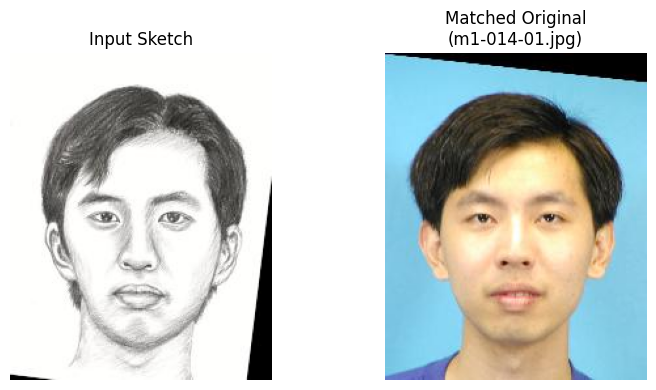

In [43]:
import os
import numpy as np
from deepface import DeepFace
import matplotlib.pyplot as plt
from PIL import Image

# Load original images & cache embeddings
original_dir = "./Datasets/faces/"
original_embeddings = {}

print("Loading original image embeddings...")
for file in os.listdir(original_dir):
    if file.endswith(".jpg"):
        path = os.path.join(original_dir, file)
        try:
            embedding = DeepFace.represent(img_path=path, model_name='Facenet')[0]["embedding"]
            original_embeddings[file] = embedding
        except Exception as e:
            print(f"Could not process {file}: {e}")

def find_closest_original(sketch_path):
    print(f"\nMatching sketch: {sketch_path}")
    sketch_embedding = DeepFace.represent(img_path=sketch_path, model_name='Facenet')[0]["embedding"]

    closest_file = None
    closest_distance = float("inf")

    for orig_file, orig_embedding in original_embeddings.items():
        distance = np.linalg.norm(np.array(sketch_embedding) - np.array(orig_embedding))
        if distance < closest_distance:
            closest_distance = distance
            closest_file = orig_file

    print(f"✅ Closest original image: {closest_file} (Distance: {closest_distance:.4f})")
    
    # Open the images using PIL
    sketch_img = Image.open(sketch_path)
    original_img = Image.open(os.path.join(original_dir, closest_file))

    # Create a new figure to plot both images
    fig, axs = plt.subplots(1, 2, figsize=(8, 4))
    
    # Plot the sketch image
    axs[0].imshow(sketch_img)
    axs[0].set_title("Input Sketch")
    axs[0].axis("off")

    # Plot the matched original image
    axs[1].imshow(original_img)
    axs[1].set_title(f"Matched Original\n({closest_file})")
    axs[1].axis("off")

    # Ensure the plot is displayed in the notebook
    plt.tight_layout()
    plt.show()  # This should work for Jupyter notebook

# === Example Usage ===
sketch_path = "./Datasets/sketches/m1-041-01-sz1.jpg"
find_closest_original(sketch_path)


In [44]:
# Load original images & cache embeddings
original_dir = "./Datasets/faces/"
original_embeddings = {}

print("Loading original image embeddings...")
for file in os.listdir(original_dir):
    if file.endswith(".jpg"):
        path = os.path.join(original_dir, file)
        try:
            embedding = DeepFace.represent(img_path=path, model_name='Facenet')[0]["embedding"]
            original_embeddings[file] = embedding
        except Exception as e:
            print(f"Could not process {file}: {e}")

# Function to calculate accuracy and distance
def evaluate_match(sketch_path, threshold=0.6):
    sketch_embedding = DeepFace.represent(img_path=sketch_path, model_name='Facenet')[0]["embedding"]

    closest_file = None
    closest_distance = float("inf")
    correct = False

    # Find the closest original image
    for orig_file, orig_embedding in original_embeddings.items():
        distance = np.linalg.norm(np.array(sketch_embedding) - np.array(orig_embedding))
        if distance < closest_distance:
            closest_distance = distance
            closest_file = orig_file

    # Consider the match correct if the distance is below the threshold
    if closest_distance < threshold:
        correct = True

    return correct, closest_file, closest_distance

def find_closest_original_with_metrics(sketch_path, threshold=0.6):
    print(f"\nMatching sketch: {sketch_path}")
    correct, closest_file, closest_distance = evaluate_match(sketch_path, threshold)

    # Print the result
    print(f"✅ Closest original image: {closest_file} (Distance: {closest_distance:.4f})")
    print(f"Match Correct: {correct}")

    sketch_img = Image.open(sketch_path)
    original_img = Image.open(os.path.join(original_dir, closest_file))

    fig, axs = plt.subplots(1, 2, figsize=(8, 4))
    axs[0].imshow(sketch_img)
    axs[0].set_title("Input Sketch")
    axs[0].axis("off")

    axs[1].imshow(original_img)
    axs[1].set_title(f"Matched Original\n({closest_file})")
    axs[1].axis("off")

    plt.tight_layout()
    plt.show()

    return correct, closest_distance

Loading original image embeddings...



Matching sketch: ./Datasets/sketches/m1-041-01-sz1.jpg
✅ Closest original image: m1-014-01.jpg (Distance: 8.5690)
Match Correct: False


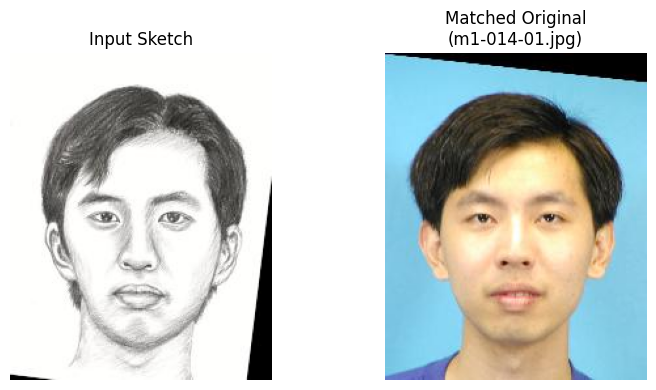


Matching sketch: ./Datasets/sketches/m1-042-01-sz1.jpg


ValueError: Confirm that ./Datasets/sketches/m1-042-01-sz1.jpg exists

In [53]:

from sklearn.metrics import accuracy_score
sketch_paths = ["./Datasets/sketches/m1-041-01-sz1.jpg", "./Datasets/sketches/m1-042-01-sz1.jpg"]
true_labels = [True, False]  # Assuming first sketch matches and second one does not

correct_matches = []
distances = []

for sketch_path, true_label in zip(sketch_paths, true_labels):
    correct, closest_distance = find_closest_original_with_metrics(sketch_path)
    correct_matches.append(correct)
    distances.append(closest_distance)

# Calculate accuracy
accuracy = accuracy_score(true_labels, correct_matches)
average_distance = np.mean(distances)



Loading original image embeddings...

Matching sketch: ./Datasets/sketches/m1-041-01-sz1.jpg
✅ Closest original image: m1-014-01.jpg (Distance: 8.5690)
Match Correct: False


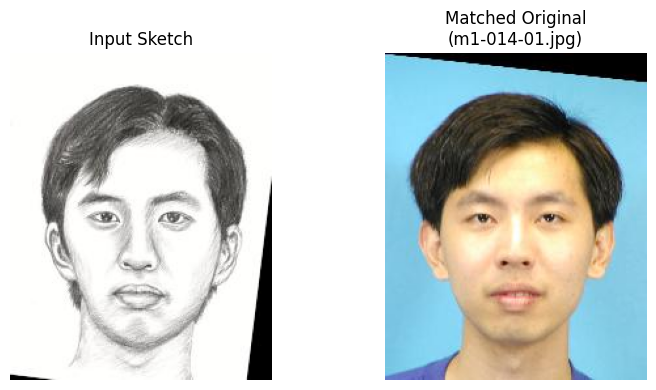


Matching sketch: ./Datasets/sketches/m1-042-01-sz1.jpg
Error: ./Datasets/sketches/m1-042-01-sz1.jpg does not exist.


In [56]:
import os
from deepface import DeepFace
import numpy as np
from PIL import Image
from sklearn.metrics import accuracy_score

# Directory paths
original_dir = "./Datasets/faces/"
sketch_dir = "./Datasets/sketches/"

original_embeddings = {}

# Load original images & cache embeddings
print("Loading original image embeddings...")
for file in os.listdir(original_dir):
    if file.endswith(".jpg"):
        path = os.path.join(original_dir, file)
        try:
            embedding = DeepFace.represent(img_path=path, model_name='Facenet')[0]["embedding"]
            original_embeddings[file] = embedding
        except Exception as e:
            print(f"Could not process {file}: {e}")

# Function to evaluate match
def evaluate_match(sketch_path, threshold=0.6):
    if not os.path.exists(sketch_path):  # Check if file exists
        print(f"Error: {sketch_path} does not exist.")
        return False, None, float('inf')

    sketch_embedding = DeepFace.represent(img_path=sketch_path, model_name='Facenet')[0]["embedding"]

    closest_file = None
    closest_distance = float("inf")
    correct = False

    # Find the closest original image
    for orig_file, orig_embedding in original_embeddings.items():
        distance = np.linalg.norm(np.array(sketch_embedding) - np.array(orig_embedding))
        if distance < closest_distance:
            closest_distance = distance
            closest_file = orig_file

    # Consider the match correct if the distance is below the threshold
    if closest_distance < threshold:
        correct = True

    return correct, closest_file, closest_distance

def find_closest_original_with_metrics(sketch_path, threshold=0.6):
    print(f"\nMatching sketch: {sketch_path}")
    correct, closest_file, closest_distance = evaluate_match(sketch_path, threshold)

    # If the sketch doesn't exist, return early
    if correct is False and closest_file is None:
        return correct, closest_distance

    # Print the result
    print(f"✅ Closest original image: {closest_file} (Distance: {closest_distance:.4f})")
    print(f"Match Correct: {correct}")

    # Load and display images
    sketch_img = Image.open(sketch_path)
    original_img = Image.open(os.path.join(original_dir, closest_file))

    fig, axs = plt.subplots(1, 2, figsize=(8, 4))
    axs[0].imshow(sketch_img)
    axs[0].set_title("Input Sketch")
    axs[0].axis("off")

    axs[1].imshow(original_img)
    axs[1].set_title(f"Matched Original\n({closest_file})")
    axs[1].axis("off")

    plt.tight_layout()
    plt.show()

    return correct, closest_distance

# Example usage
sketch_paths = ["./Datasets/sketches/m1-041-01-sz1.jpg", "./Datasets/sketches/m1-042-01-sz1.jpg"]
true_labels = [True, False]  # Assuming first sketch matches and second one does not

correct_matches = []
distances = []

for sketch_path, true_label in zip(sketch_paths, true_labels):
    correct, closest_distance = find_closest_original_with_metrics(sketch_path)
    correct_matches.append(correct)
    distances.append(closest_distance)

# Calculate accuracy
accuracy = accuracy_score(true_labels, correct_matches)
average_distance = np.mean(distances)



In [57]:
print(f"\nAccuracy: {accuracy*100:.4f}")



Accuracy: 50.0000
